In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.optimize import curve_fit

In [2]:
# Make the plots a bit bigger to see
# NOTE: Must be done in a separate cell
plt.rcParams['figure.dpi'] = 100

In [3]:
# path1 = "Data_ccr/par_set_2_psd/vrun0_d2_40/"
# path1 = "../NoneqTrans2/Data_test/vrun3_d1_60/"
# path1 = "../NoneqTrans2/Data_test/80x80/vrun3_d1_60/"
path1 = "../../../../../../Volumes/Kunal_EHD/Work/Codes/RS_data_122920/par_set1_cbc/vrun1_d1_80/"
# path2 = "../NoneqTrans2/Data_test/80x80/vrun2_d1_40/"
# path1 = "../NoneqTrans2/Data_test/par_set1/vrun1_d1_85/"
# Python Data Single run
A1 = np.loadtxt(path1 + "delta_f2py_test.dat")
nn = np.size(A1,0)
print(np.shape(A1))

#### Python Data Voltage Up
E_up = A1[:,0]
# T_up = A1[:,0]
delta_up = A1[:,1]
I_up = A1[:,6]
Vs_up = A1[:,4]
R_up = A1[:,7]
# dR_up = A1[:,9]
# mx = 64
# my = 64

mx = 64
my = 64

inputs = open(path1+"input_par.dat", "r")
Nsamp = 128
maxdist = mx//2

# Vcrit = 691.2
Vcrit = 672.
# Vcrit = 537.6
print(inputs.read())

(200, 11)
{'mx': 64, 'my': 64, 'nwarm': 400000, 'nskip': 16, 'Tc': 1.0, 'coef': 0.1, 'dphi': 0.2, 'gamma': 0.1, 'r0': 3.5, 'g2': 1.0, 'g4': -1.0, 'g6': 0.5, 'Rload': 1.0, 'mfphi': False, 'tloop': False}{'Tcrit': 1.32, 'dE': 0.1, 'minE': 0.1, 'maxE': 20.1, 'dTb': 0.01, 'minT': 0.01, 'maxT': 2.01, 'nmeas': 2048, 'Tbath': 0.8, 'seed': 34882383, 'NPEs': 1, 'iphi': True}


## Distribution plots

In [4]:
#### Voltage Domain plots

mxphi = []
mnphi = []

mxdphi = []
mndphi = []
for i in range(nn):
    phi = np.loadtxt(path1 + "phi_val_"+ format(E_up[i], '.2f')+ "_"+ str(Nsamp-1)+ "_.dat")
    dphi = phi - np.mean(phi)
    mxphi.append(np.max(phi))
    mnphi.append(np.min(phi))
    mxdphi.append(np.max(dphi))
    mndphi.append(np.min(dphi))


maxphi = np.max(mxphi)
minphi = np.min(mnphi)
maxdphi = np.max(mxdphi)
mindphi = np.min(mndphi)
print( minphi, maxphi)
print(mindphi, maxdphi)

-1.9357641254100417 2.357018951901442
-2.7340746562380187 1.8853277955888101


In [5]:
#### Voltage Domain plots

rows = 20
columns = 10
fig, axes = plt.subplots(figsize=(columns*10+15, rows*10+15 ))
# fig=plt.figure(figsize=(100, 8))
fig.suptitle = "$\phi$ distribution, $T_B = 0.85*T_C$"
for i in range(rows*columns):
    phi = np.loadtxt(path1 + "phi_val_"+ format(E_up[i], '.2f')+ "_"+ str(Nsamp-1)+ "_.dat")
    fig.add_subplot(rows, columns, (i+1))
#     phi2 = phi**2
#     dist = plt.imshow(np.transpose(phi),cmap='plasma',origin='lower', vmin = minphi, vmax = maxphi)
    x, y = np.meshgrid(np.arange(mx), np.arange(my))
    plt.contourf(x,y,np.transpose(phi), cmap='plasma', origin='lower', vmin = minphi, vmax = maxphi)
#     plt.colorbar(dist)
    plt.title("Vt = "+format(E_up[i]*my, '.2f') , fontsize = 80)
    plt.xlabel("m_x")
    plt.ylabel("m_y")
# plt.legend()


# plt.title('$N_{meas}$=1024, $g_2 = 1$ , $g_4 = -1$, $g_6 = 0.5$, $r_0 = 3.5$')
# fig.colorbar(dist)
plt.savefig(path1 + "Dist_phi_Tbath=0.85*Tc.pdf",bbox_inches='tight')

plt.show()


## Pair Correlation calculations

In [6]:
#### Corelations along Y ####
def pair_corY(phi,av_phi,a):
    nx,ny = np.shape(phi)
    gx = np.zeros(nx)
    for i in range(nx):
        gg = 0
        for j in range(ny):
            if j < (ny-a):
                gg += (phi[i,(j+a)] - av_phi[i,(j+a)])*(phi[i,j] - av_phi[i,j])
        gx[i] = gg/(ny-a)
    return np.mean(gx)
    

#### Correlations along X ####
def pair_corX(phi,av_phi,a):
    nx,ny = np.shape(phi)
    gy = np.zeros(ny)
    for j in range(ny):
        gg = 0
        for i in range(nx):
            if i < (nx-a):
                gg += (phi[(i+a),j] - av_phi[(i+a),j])*(phi[i,j] - av_phi[i,j])
        gy[j] = gg/(nx-a)
    return np.mean(gy)





In [7]:
rows = 20
columns = 10
fig2, axes2 = plt.subplots(figsize=(columns*10+15, rows*10+15 ))

for k in range(nn):
    av_phi = np.zeros((mx,my))
    for tt in range(Nsamp-1):
        phi = np.loadtxt(path1 + "phi_val_"+ format(E_up[k], '.2f')+ "_"+ str(tt)+ "_.dat")
        av_phi += phi
    globals()["av_phi_" + str(k)] = av_phi/Nsamp
    fig2.add_subplot(rows, columns, (k+1))
#     phi2 = phi**2
#     dist = plt.imshow(np.transpose(phi),cmap='plasma',origin='lower', vmin = minphi, vmax = maxphi)
    x, y = np.meshgrid(np.arange(mx), np.arange(my))
    plt.contourf(x,y,np.transpose(globals()["av_phi_" + str(k)]), cmap='plasma', origin='lower', vmin = minphi, vmax = maxphi)
#     plt.colorbar(dist)
    plt.title("Vt = "+format(E_up[k]*my, '.2f') , fontsize = 80)
    plt.xlabel("m_x")
    plt.ylabel("m_y")
# plt.legend()


# plt.title('$N_{meas}$=1024, $g_2 = 1$ , $g_4 = -1$, $g_6 = 0.5$, $r_0 = 3.5$')
# fig.colorbar(dist)
plt.savefig(path1 + "Dist_avphi_Tbath=0.85*Tc.pdf",bbox_inches='tight')

plt.show()



In [8]:
# A = np.zeros((10,10))
# B = np.zeros((10,10))

# for ii in range(10):
#     for jj in range(10):
#         A[ii,jj] = ii + jj 
# print(A)
# for i in range(10):
#     B += A


# print(B)    
# plt.imshow(av_phi_120)

In [9]:
Gx_full = np.zeros((nn,maxdist*Nsamp))
Gy_full = np.zeros((nn,maxdist*Nsamp))

G_x = np.zeros((nn,maxdist))
G_y = np.zeros((nn,maxdist))
k = 0 
for E in E_up:    
    Gx_ = np.zeros((Nsamp,maxdist))
    Gy_ = np.zeros((Nsamp,maxdist))
    
    for l in range(Nsamp):
        phi = np.loadtxt(path1 + "phi_val_"+ format(E, '.2f')+ "_"+ str(l)+ "_.dat")
        phiav = globals()["av_phi_" + str(k)]
        gofrx = []
        gofry = []
        dist = 0
        for dist in range(maxdist):
            gg1 = pair_corX(phi,phiav,dist)
            gofrx.append(gg1)
            gg2 = pair_corY(phi,phiav,dist)
            gofry.append(gg2)
        Gx_[l,:] = gofrx[:]
        Gy_[l,:] = gofry[:]
#         Gx_full[k,:,l] = gofrx[:]
#         Gy_full[k,:,l] = gofry[:]
    
    Gx_full[k,:] = Gx_.flatten('F')
    Gy_full[k,:] = Gy_.flatten('F')
    x_ax = np.arange(0,maxdist)
    G_x[k,:] = np.mean(Gx_,axis = 0)
    G_y[k,:] = np.mean(Gy_,axis = 0)
    
    k +=1
#     plt.plot(x_ax,G_x[k,:], label = " Perpendicular to the field")
#     plt.plot(x_ax,G_y[k,:], label = " Parallel to field")
    
#     plt.ylabel("g(r)")
#     plt.xlabel("r")
#     plt.title("E = "+ format(E*80.,'.2f'))
#     plt.grid(b=True,which='major', axis='both')
#     plt.legend()
# #     plt.savefig(path1 + "corr_n_"+str(n)+"_.pdf")
#     plt.savefig(path2 + "gofr_Vt_"+format(E*my,'.2f')+"_cbc.pdf",bbox_inches='tight')
# #     plt.show()

np.savetxt(path1 + 'gofr_x2.dat', G_x)
np.savetxt(path1 + 'gofr_y2.dat', G_y)

np.savetxt(path1 + 'gofr_x_full2.dat', Gx_full)
np.savetxt(path1 + 'gofr_y_full2.dat', Gy_full)

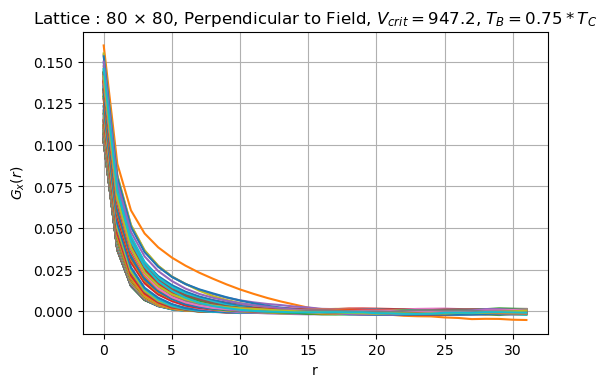

In [10]:
for k in range(0,nn):
    plt.plot(x_ax,G_x[k,:],label = "E = " + format(E_up[k]*(mx), '.2f') )

plt.title(r'Lattice : 80 $\times$ 80, Perpendicular to Field, $V_{crit} = 947.2$, $T_B = 0.75*T_C$')
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left') 
plt.grid(b=True,which='major', axis='both')
plt.ylabel('$G_x(r)$')
plt.xlabel('r')

# plt.savefig(path1 + "gofrx_75%_full.pdf",bbox_inches='tight')
plt.show()    

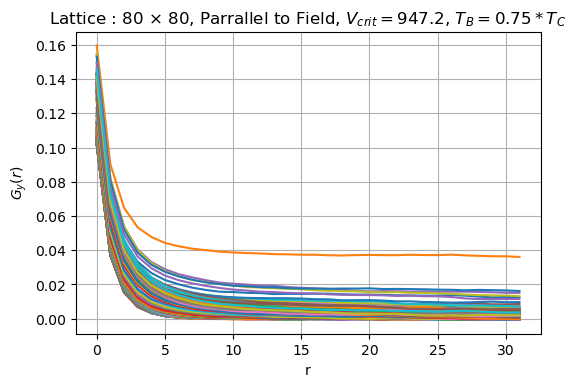

In [11]:
for k in range(0,nn):
    plt.plot(x_ax,G_y[k,:],label = "E = " + format(E_up[k]*(my), '.2f') )

plt.title(r'Lattice : 80 $\times$ 80, Parrallel to Field, $V_{crit} = 947.2$, $T_B = 0.75*T_C$')
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left') 
plt.grid(b=True,which='major', axis='both')
plt.ylabel('$G_y(r)$')
plt.xlabel('r')  
# plt.savefig(path1 + "gofry_75%_full.pdf",bbox_inches='tight')
plt.show()    

Text(0.5, 0, 'r')

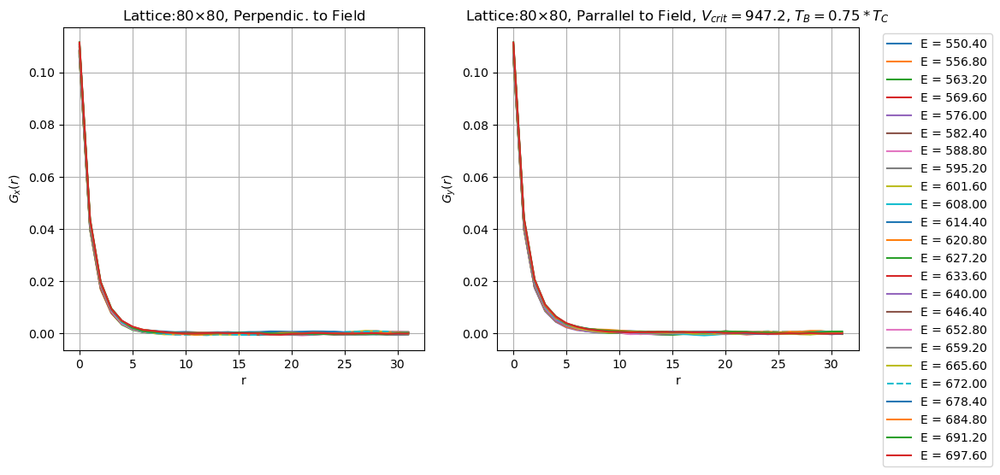

In [12]:
f = plt.figure(figsize=(12, 5)); # plot the calculated values    


sp =  f.add_subplot(1, 2, 1 );
for k in range(0,nn):
    if E_up[k]*my == Vcrit:
        plt.plot(x_ax,G_x[k,:],label = "E = " + format(E_up[k]*(my), '.2f'), linestyle = 'dashed' )
    elif E_up[k]*my > 550. and E_up[k]*my < 700. :
#     if k%4 == 0:
        plt.plot(x_ax,G_x[k,:],label = "E = " + format(E_up[k]*(my), '.2f') )
    else:
        None

plt.title(r'Lattice:80$\times$80, Perpendic. to Field')

# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left') 
plt.grid(b=True,which='major', axis='both')
plt.ylabel('$G_x(r)$')
plt.xlabel('r')
   
# plt.show()    


sp =  f.add_subplot(1, 2, 2 );
for k in range(0,nn):
    if E_up[k]*my == Vcrit:
        plt.plot(x_ax,G_y[k,:],label = "E = " + format(E_up[k]*(my), '.2f'), linestyle = 'dashed' )
    elif E_up[k]*my > 550. and E_up[k]*my < 700. :
#     if k%4 == 0:
        plt.plot(x_ax,G_y[k,:],label = "E = " + format(E_up[k]*(my), '.2f') )
    else:
        None



plt.title(r'Lattice:80$\times$80, Parrallel to Field, $V_{crit} = 947.2$, $T_B = 0.75*T_C$')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left') 
plt.grid(b=True,which='major', axis='both')
plt.ylabel('$G_y(r)$')
plt.xlabel('r')  
# plt.show()


# plt.savefig(path1 + "gofr_75%.pdf",bbox_inches='tight')